In [1]:
import numpy as np
import h5py
import matplotlib.pylab as plt
import sys
import sigpy
sys.path.append('../../../src/')

# custom scripts
import mri_cs
from undersampling import radial_sampling
from helpers import calculate_metrics, get_proportion, zero_fill, create_mask

from importlib import reload
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
%matplotlib inline

plt.style.use('dark_background')
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['figure.figsize'] = (10.0, 8.0)

# Shape: (frame_count, rows, cols)

In [2]:
import matplotlib.image as mpimg
import os

img_dir = "./frames/"
frames = []

for f in sorted(os.listdir(img_dir)):
    img = mpimg.imread(os.path.join(img_dir, f))
    # only take first channel and square image
    img = img[:, 40:280, 0]
    frames.append(img)

frames = np.array(frames)
rows, cols = frames.shape[1:3]
frames.shape

(10, 240, 240)

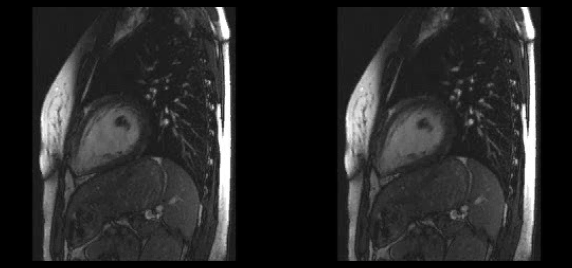

In [3]:
fig, ax = plt.subplots(nrows=1, ncols=2)
_ = ax[0].imshow(frames[0, ...])
_ = ax[0].axis('off')
_ = ax[1].imshow(frames[-1, ...])
_ = ax[1].axis('off')

# Segmentation masks

In [4]:
# from undersampling import equispaced_mask

# mask = equispaced_mask((rows, cols), center_fraction=0.08, acceleration=4)

# samples_rows = np.nonzero(mask.flatten())[0]
# # b = np.fft.fft2(frames[0, ...]).flatten()[samples_rows]

# b = []
# for i in range(frames.shape[0]):
#     b.append(np.fft.fft2(frames[i, ...]).flatten()[samples_rows])
    
# # b = np.array(b)
# # get_proportion(frames[0, ...].flatten(), b[0])
# # b.shape

# # _ = plt.imshow(np.fft.fftshift(radial_mask))

# get_proportion(frames[0, ...].flatten(), b[0])
# _ = plt.imshow(np.fft.fftshift(mask))

0.18338541666666666

(10, 10563)

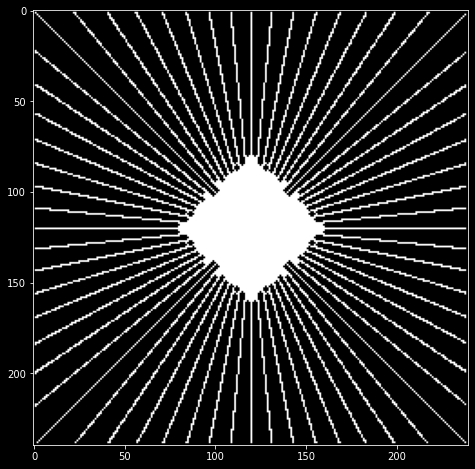

In [5]:
radial_mask = np.fft.fftshift(radial_sampling(rows, cols, 64, dilations=0))
samples_rows = np.where(radial_mask.flatten())[0]

b = []
for i in range(frames.shape[0]):
    b.append(np.fft.fft2(frames[i, ...]).flatten()[samples_rows])
    
b = np.array(b)
get_proportion(frames[0, ...].flatten(), b[0])
b.shape

_ = plt.imshow(np.fft.fftshift(radial_mask))

PSNR: 29.49261501851148
SSIM: 0.748938247787845
SNR: 18.10959759715149
NMSE: 0.01545397624318002
MSE: 73.08341944228573


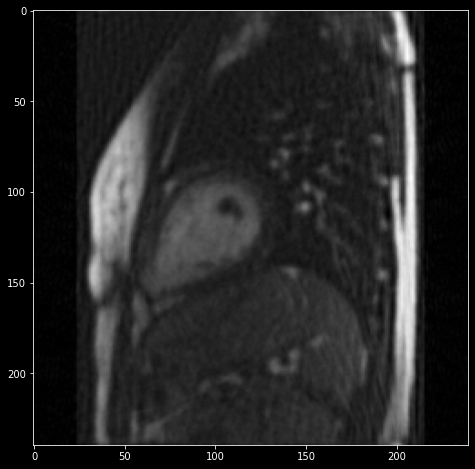

In [6]:
zero_filled = zero_fill(b[0], samples_rows, rows, cols)

_ = plt.imshow(np.abs(zero_filled))
_ = plt.grid(False)
_ = calculate_metrics(frames[0, ...], np.abs(zero_filled))

# No prior information LP minimization

<module 'mri_cs' from '../../../src/mri_cs.py'>

####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 19.69112801551819s
PSNR: 31.308764807836866
SSIM: 0.8463741181727797
SNR: 19.92574738647688
NMSE: 0.010172442914142548
MSE: 48.106513207244795


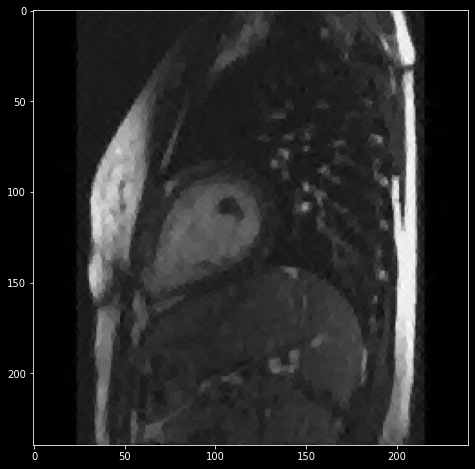

In [7]:
import mri_cs
reload(mri_cs)

filters = [[[1.0, -1.0], [1.0, -1.0]],
            [[1.0, 1.0], [-1.0, -1.0]],
            [[1.0, -1.0], [-1.0, 1.0]]]

tol_cg = 1e-3
maxiter_cg = 2 * b[0].size
maxiterperstage = 30

frame_recons = []

nopi_recon = mri_cs.prefiltering(samples_rows, b[0], rows=rows, columns=cols, h=filters, 
                                 p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                 number_jobs=1, maxiterperstage=maxiterperstage,
                                 verbose=False)

_ = plt.imshow(np.abs(nopi_recon))
_ = calculate_metrics(np.abs(frames[0, ...]), np.abs(nopi_recon))
frame_recons.append(nopi_recon)

# Visualizing prior information leveraged

<module 'mri_cs' from '../../../src/mri_cs.py'>

CRIS PI


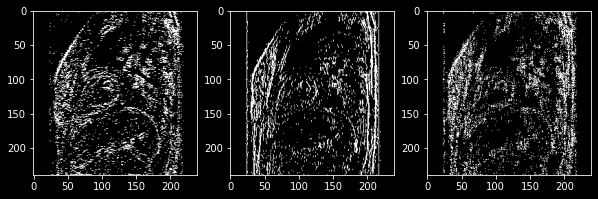

In [8]:
reload(mri_cs)

phi = mri_cs.prior_information(np.abs(frame_recons[0]), pi_prop=13/100, filters=filters)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
_ = ax1.imshow(create_mask(phi[0], rows=rows, cols=cols))
_ = ax2.imshow(create_mask(phi[1], rows=rows, cols=cols))
_ = ax3.imshow(create_mask(phi[2], rows=rows, cols=cols))

# Next frame's reconstructions

PSNR: 29.4792431109913
SSIM: 0.7486516089129716
SNR: 18.097862681142175
NMSE: 0.01549579034692757
MSE: 73.30878974031408


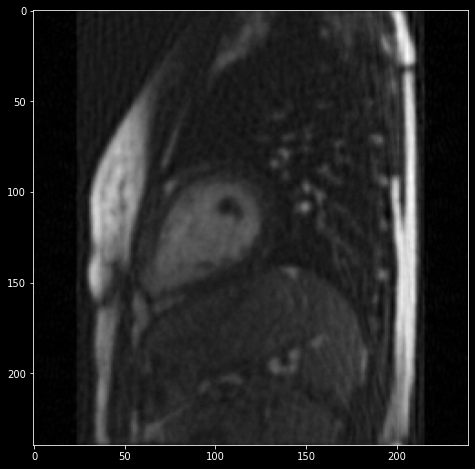

In [9]:
zero_filled = zero_fill(b[1], samples_rows, rows, cols)

_ = plt.imshow(np.abs(zero_filled))
_ = plt.grid(False)
_ = calculate_metrics(frames[1, ...], np.abs(zero_filled))

# No PI Frame 1 reconstruction

<module 'mri_cs' from '../../../src/mri_cs.py'>

(240, 240)

(7488,)

####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 15.553570747375488s
PSNR: 31.240377470898963
SSIM: 0.8453331862049677
SNR: 19.858997041049836
NMSE: 0.01032999939050077
MSE: 48.87003091687692


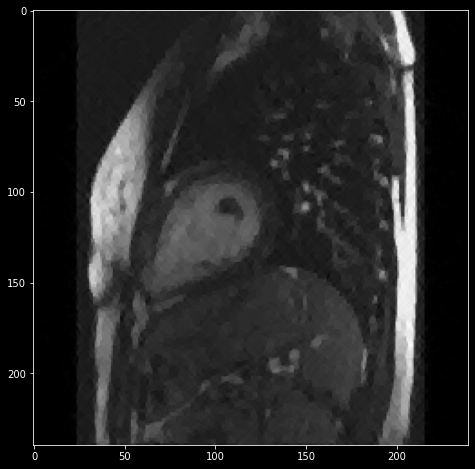

In [10]:
import mri_cs
reload(mri_cs)

rows, cols = frames[1, ...].shape
tol_cg = 1e-3
maxiter_cg = 2 * b[0].size
maxiterperstage = 30

rows, cols
phi[0].shape

nopi_recon = mri_cs.prefiltering(samples_rows, b[1], rows, cols, h=filters, 
                                 p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                 maxiterperstage=maxiterperstage, verbose=False)

_ = calculate_metrics(np.abs(frames[1, ...]), np.abs(nopi_recon))
_ = plt.imshow(np.abs(nopi_recon))

# Reconstruct next frame with this recontruction's deterministic prior information

# Apply different covariance matrices for different regions

<module 'annotation' from '../../../src/annotation.py'>

{'high': [array([21461, 21462, 21463, ..., 38468, 38469, 38470])],
 'medium': [array([34929, 34930, 34931, ..., 57046, 57047, 57048]),
  array([11192, 11193, 11431, ..., 40990, 40991, 41231])],
 'low': [array([ 2964,  3203,  3204, ..., 54515, 54755, 54995]),
  array([  679,   918,   919, ..., 57323, 57324, 57325])]}

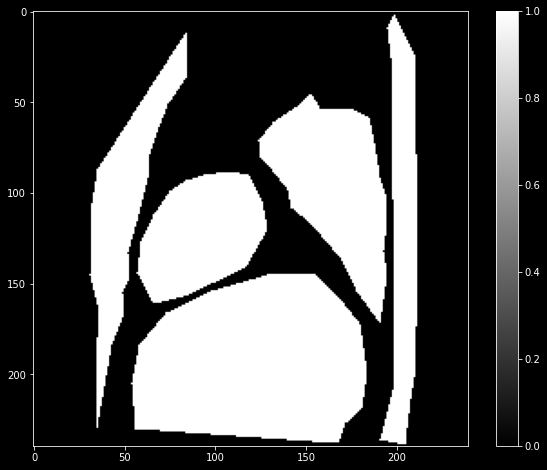

In [11]:
import annotation
reload(annotation)

json_path = '../../../data/project-4-at-2021-04-11-15-00-46ef0a68.json'

annot = annotation.Annotation(json_path, crop_shape=(240, 240))
segmentation_phi = annot.get_phi()
annot.disp_matrix(label="all")
annot.get_phi()

In [63]:
segmentation_phi

{'high': [array([21461, 21462, 21463, ..., 38468, 38469, 38470])],
 'medium': [array([34929, 34930, 34931, ..., 57046, 57047, 57048]),
  array([11192, 11193, 11431, ..., 40990, 40991, 41231])],
 'low': [array([ 2964,  3203,  3204, ..., 54515, 54755, 54995]),
  array([  679,   918,   919, ..., 57323, 57324, 57325])]}

In [12]:
import gaussian_2d_domain
reload(gaussian_2d_domain)

high_mov_var =  100 ** 2
medium_mov_var = 50 ** 2
low_mov_var =  5 ** 2

cov_matrix_dict = {}
cov_matrix_dict["low"] = np.array([[low_mov_var, 0], [0, low_mov_var]])
cov_matrix_dict["medium"] = np.array([[medium_mov_var, 0], [0, medium_mov_var]])
cov_matrix_dict["high"] = np.array([[high_mov_var, 0], [0, high_mov_var]])

# low_phi = dict()
# low_phi["low"] = segmentation_phi["low"]
# low_phi["medium"] = segmentation_phi["medium"]
low_phi = segmentation_phi
low_phi

# cov_matrix_dict
weights, I, J = gaussian_2d_domain.weights_from_prior(phis=low_phi, rows=annot.shape[0], 
                                                      columns=annot.shape[1], cov_matrix=cov_matrix_dict,
                                                      taufactor=1e6, taumin=1)

<module 'gaussian_2d_domain' from '../../../src/gaussian_2d_domain.py'>

{'high': [array([21461, 21462, 21463, ..., 38468, 38469, 38470])],
 'medium': [array([34929, 34930, 34931, ..., 57046, 57047, 57048]),
  array([11192, 11193, 11431, ..., 40990, 40991, 41231])],
 'low': [array([ 2964,  3203,  3204, ..., 54515, 54755, 54995]),
  array([  679,   918,   919, ..., 57323, 57324, 57325])]}

In [13]:
import plotly.express as px
# plt.imshow(create_mask(phi[0], rows=rows, cols=cols))
gaussian_weights = [(create_mask(i, rows=rows, cols=cols) * weights).flatten() for i in phi]
# plt.imshow(np.reshape(gaussian_weights[0], (rows,cols)))
# plt.colorbar()
px.imshow(np.reshape(gaussian_weights[0], (rows,cols)))
np.reshape(gaussian_weights[0], (rows,cols)).min()

# plt.imshow(create_mask(weighted_phis[0], rows=rows, cols=cols))

0.0

In [14]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Surface(z=weights)])

fig.update_layout(title='Segmentation', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

In [15]:
def normalize(array, tau, bias=1000):
    return (array / np.max(array) * tau) + bias

def normalize_zeroone(array):
    normalized = (array - np.min(array)) / (np.max(array) - np.min(array)) + 0.1
    return normalized

gaussian_weights = [(create_mask(i, rows=rows, cols=cols) * weights).flatten() for i in phi]
gaussian_weights = [normalize(i, tau=1e3, bias=1e3) for i in gaussian_weights]
# gaussian_weights = [normalize_zeroone(i) for i in gaussian_weights]
np.unique(gaussian_weights)
px.imshow(np.reshape(gaussian_weights[0], (rows, cols)))

array([1000.        , 1041.14703804, 1041.43203681, ..., 1999.33608535,
       1999.94806927, 2000.        ])

# Deterministic PI

In [24]:
phi


[array([   27,    28,    35, ..., 57565, 57567, 57568]),
 array([   24,    35,    36, ..., 57564, 57573, 57576]),
 array([   29,    35,    36, ..., 57565, 57576, 57577])]

array([2773502.             +0.j        ,
       -203774.36434727 +25009.90851359j,
       -698110.08687729+247557.65594748j, ...,
        216499.7206293  +53327.93719523j,
        103035.88299971 -12446.27217334j,
       -146085.1284872 -171782.92979924j])

<module 'mri_cs' from '../../../src/mri_cs.py'>

(240, 240)

(7488,)

####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 30.499826908111572s
PSNR: 30.714785636231152
SSIM: 0.8348814839713883
SNR: 19.33340520638203
NMSE: 0.011658951061777943
MSE: 55.15714738293147


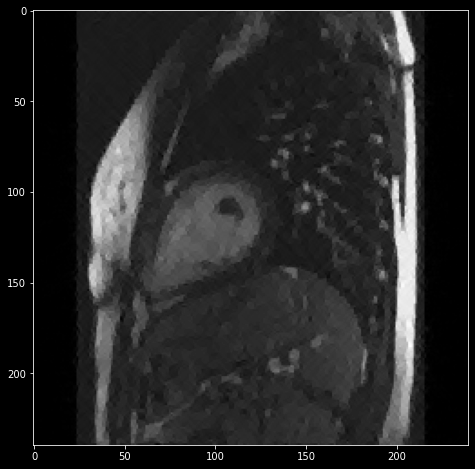

In [29]:
import mri_cs
reload(mri_cs)

rows, cols = frames[1, ...].shape
tol_cg = 1e-3
maxiter_cg = 2 * b[0].size
maxiterperstage = 30

rows, cols
phi[0].shape

nopi_recon = mri_cs.prefiltering(samples_rows, b[1], rows, cols, h=filters, 
                                 p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                 phi=phi, tau=1e-1, maxiterperstage=maxiterperstage, verbose=False)

_ = calculate_metrics(np.abs(frames[1, ...]), np.abs(nopi_recon))
_ = plt.imshow(np.abs(nopi_recon))

# Gaussian normalized different covariances

<module 'gaussian_mri_cs' from '../../../src/gaussian_mri_cs.py'>

####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 23.148659229278564s
PSNR: 31.182430620236676
SSIM: 0.8471923269869128
SNR: 19.80105019038755
NMSE: 0.010468753669878206
MSE: 49.52646134505876


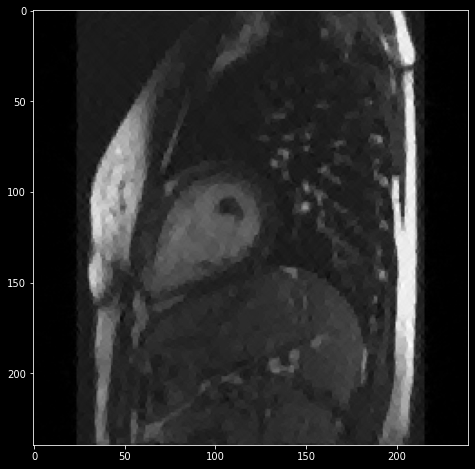

In [30]:
import gaussian_mri_cs
reload(gaussian_mri_cs)

rows, cols = frames[1, ...].shape
tol_cg = 1e-3
maxiter_cg = 2 * b[1].size
maxiterperstage = 30

# phi = mri_cs.prior_information(np.abs(frame_recons[0]), pi_prop=13/100, filters=filters)

pi_recon = gaussian_mri_cs.prefiltering(samples_rows, b[1], rows, cols, h=filters, 
                                        p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                        maxiterperstage=maxiterperstage,
                                        phi=phi, gaussian_weights=gaussian_weights, verbose=False)

_ = plt.imshow(np.abs(pi_recon))
_ = calculate_metrics(np.abs(frames[1, ...]), np.abs(pi_recon))

<module 'gaussian_mri_cs' from '../../../src/gaussian_mri_cs.py'>

####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 21.505361080169678s
PSNR: 31.207038470273822
SSIM: 0.8442317488322151
SNR: 19.8256580404247
NMSE: 0.010409603699752546
MSE: 49.24662968587864


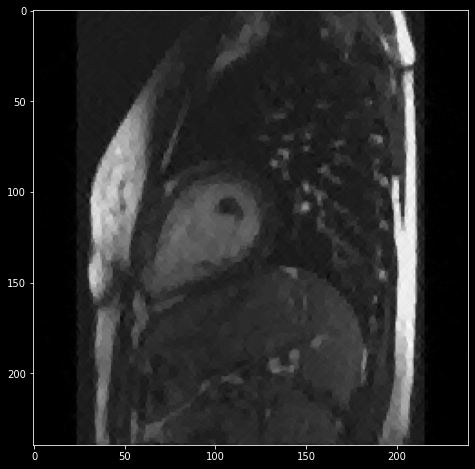

In [108]:
import gaussian_mri_cs
reload(gaussian_mri_cs)

rows, cols = frames[1, ...].shape
tol_cg = 1e-3
maxiter_cg = 2 * b[1].size
maxiterperstage = 30

# phi = mri_cs.prior_information(np.abs(frame_recons[0]), pi_prop=13/100, filters=filters)

pi_recon = gaussian_mri_cs.prefiltering(samples_rows, b[1], rows, cols, h=filters, 
                                        p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                        maxiterperstage=maxiterperstage,
                                        phi=phi, gaussian_weights=gaussian_weights, verbose=False)

_ = plt.imshow(np.abs(pi_recon))
_ = calculate_metrics(np.abs(frames[1, ...]), np.abs(pi_recon))

# gaussian deterministic

<module 'gaussian_mri_cs' from '../../../src/gaussian_mri_cs.py'>

CRIS PI
####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 46.35875964164734s
PSNR: 30.69596642381456
SSIM: 0.8342875974218662
SNR: 19.314585993965437
NMSE: 0.011709582225881638
MSE: 55.396677557287575


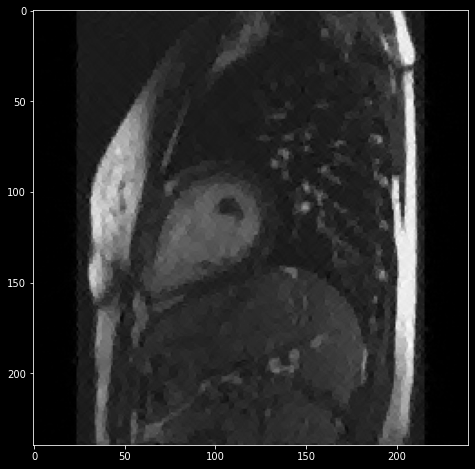

In [45]:
import gaussian_mri_cs
reload(gaussian_mri_cs)

rows, cols = frames[1, ...].shape
tol_cg = 1e-3
maxiter_cg = 2 * b[1].size
maxiterperstage = 30

phi = mri_cs.prior_information(np.abs(frame_recons[0]), pi_prop=13/100, filters=filters)

pi_recon = gaussian_mri_cs.prefiltering(samples_rows, b[1], rows, cols, h=filters, 
                                        p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                        maxiterperstage=maxiterperstage,
                                        phi=phi, gaussian_weights=gaussian_weights, verbose=False)

_ = plt.imshow(np.abs(pi_recon))
_ = calculate_metrics(np.abs(frames[1, ...]), np.abs(pi_recon))

In [ ]:
import mri_cs
reload(mri_cs)

rows, cols = frames[1, ...].shape
tol_cg = 1e-3
maxiter_cg = 2 * b[0].size
maxiterperstage = 30
tau = 1e-1

rows, cols
phi[0].shape
phi = mri_cs.prior_information(np.abs(frame_recons[0]), pi_prop=13/100, filters=filters)

pi_recon = mri_cs.prefiltering(samples_rows, b[1], rows, cols, h=filters, 
                               p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                               maxiterperstage=maxiterperstage,
                               phi=phi, tau=tau, verbose=False)

_ = plt.imshow(np.abs(pi_recon))
_ = calculate_metrics(np.abs(frames[1, ...]), np.abs(pi_recon))

In [ ]:
============================
PSNR: 30.714785636231152
SSIM: 0.8348814839713883
SNR: 19.33340520638203
NMSE: 0.011658951061777943
MSE: 55.15714738293147
============================

In [31]:
q = np.ones(shape=(N,))
q[phi[0]] /= 1e-1
px.imshow(np.reshape(q, (rows, cols)))

<module 'gaussian_mri_cs' from '../../../src/gaussian_mri_cs.py'>

####### Reconstructing filtered image 1 of 3 #######


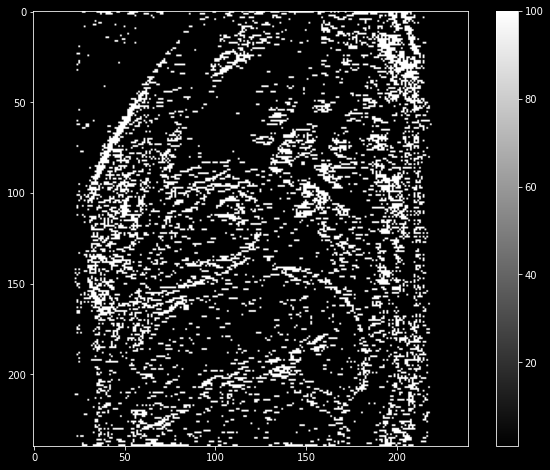

####### Reconstructing filtered image 2 of 3 #######


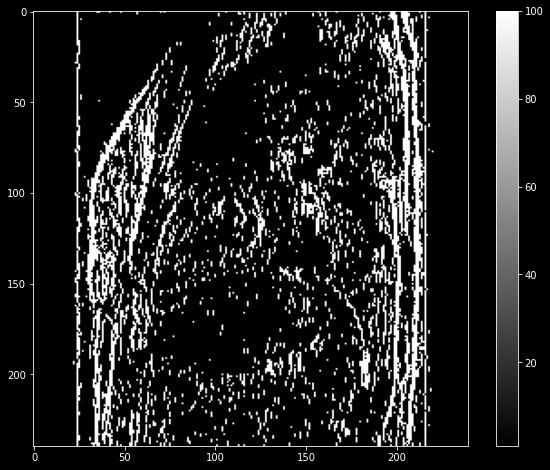

####### Reconstructing filtered image 3 of 3 #######


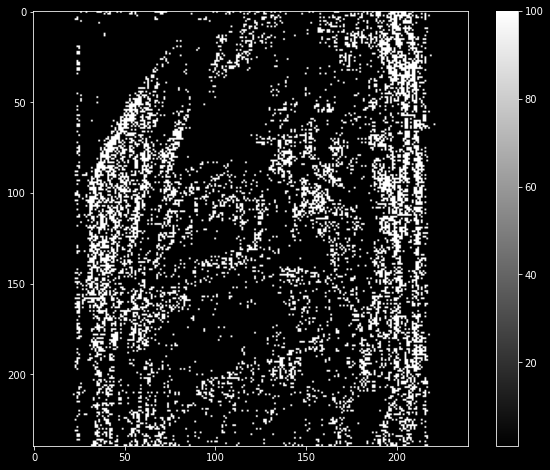

Prefiltering elapsed time: 177.6456868648529s
PSNR: 29.1534173524748
SSIM: 0.7830871567517445
SNR: 17.772036922625677
NMSE: 0.016703070252240177
MSE: 79.02029117101179


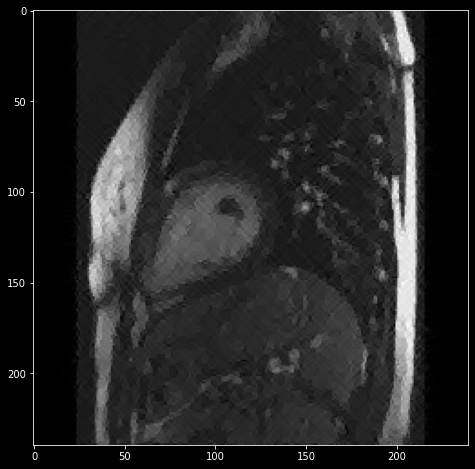

In [141]:
import gaussian_mri_cs
reload(gaussian_mri_cs)

rows, cols = frames[1, ...].shape
tol_cg = 1e-3
maxiter_cg = 2 * b[1].size
maxiterperstage = 30

pi_recon = gaussian_mri_cs.prefiltering(samples_rows, b[1], rows, cols, h=filters, 
                                        p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                        maxiterperstage=maxiterperstage,
                                        phi=phi, gaussian_weights=gaussian_weights, verbose=False)

_ = plt.imshow(np.abs(pi_recon))
_ = calculate_metrics(np.abs(frames[1, ...]), np.abs(pi_recon))

In [95]:
reload(gaussian_2d_domain)
weighted_phis = gaussian_2d_domain.get_phis(weights, phi, rows=rows, cols=cols)
weighted_phis

<module 'gaussian_2d_domain' from '../../../src/gaussian_2d_domain.py'>

NameError: name 'phi' is not defined

In [ ]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Surface(z=weights)])

fig.update_layout(title='Segmentation', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

In [ ]:
# phi[0]
# _ = ax1.imshow(create_mask(phi[0], rows=rows, cols=cols))
det = create_mask(phi[0], rows,cols)
weighted_pi = det * weights
plt.imshow(weighted_pi)

In [23]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Surface(z=weights)])

fig.update_layout(title='Segmentation', autosize=False,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))

In [71]:
import plotly.express as px
px.imshow(weights, labels=dict(x="X", y="Y", color="Magnitude"), color_continuous_scale="magma")

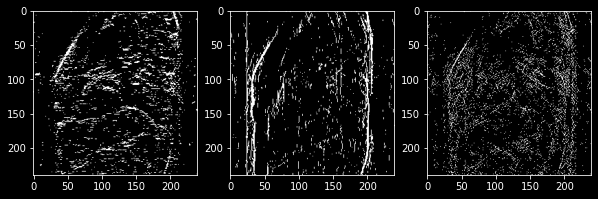

In [76]:
fig, ax = plt.subplots(1, 3)
for i in range(3):
    _ = ax[i].imshow(create_mask(weighted_phis[i], rows=rows, cols=cols))

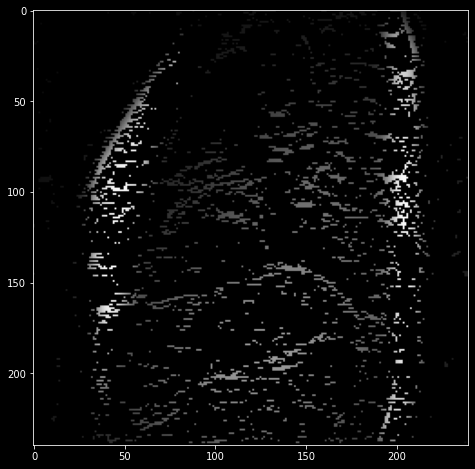

In [83]:
plt.imshow(create_mask(phi[0], rows=rows, cols=cols) * weights)
# plt.imshow(create_mask(weighted_phis[0], rows=rows, cols=cols))

<module 'mri_cs' from '../../../src/mri_cs.py'>

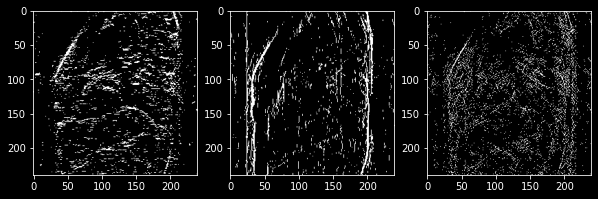

In [77]:
reload(mri_cs)

phi = mri_cs.prior_information(np.abs(frame_recons[0]), pi_prop=8/100, filters=filters)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
_ = ax1.imshow(create_mask(phi[0], rows=rows, cols=cols))
_ = ax2.imshow(create_mask(phi[1], rows=rows, cols=cols))
_ = ax3.imshow(create_mask(phi[2], rows=rows, cols=cols))

<module 'gaussian_mri_cs' from '../../../src/gaussian_mri_cs.py'>

####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 87.32703924179077s
PSNR: 32.107246072811705
SSIM: 0.8655220563669475
SNR: 19.80181195694886
MSE: 49.51777500545593


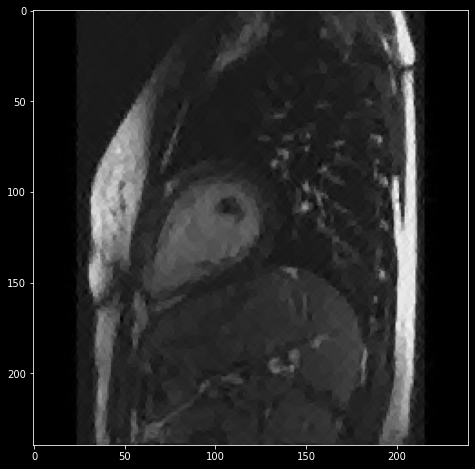

In [85]:
import gaussian_mri_cs
reload(gaussian_mri_cs)

rows, cols = frames[1, ...].shape
tol_cg = 1e-3
maxiter_cg = 2 * b.size
maxiterperstage = 30
tau = 1e-1

pi_recon = gaussian_mri_cs.prefiltering(samples_rows, b[1], rows, cols, h=filters, 
                                        p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                        maxiterperstage=maxiterperstage,
                                        phi=phi, gaussian_weights=weights, verbose=False)

_ = plt.imshow(np.abs(pi_recon))
_ = calculate_metrics(np.abs(frames[1, ...]), np.abs(pi_recon))

In [95]:
from tqdm.notebook import tqdm


det_recons = []
gaus_recons = []
phis = []
weights_list = []
# from second frame onwards
for idx, measurements in tqdm(enumerate(b)):
    # skip first frame
    if idx == 0:
        continue

    determin_recon = mri_cs.prefiltering(samples_rows, b=measurements, rows=rows, columns=cols, h=filters, 
                                         p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                         maxiterperstage=maxiterperstage,
                                         phi=phi, tau=tau, verbose=False)

    det_recons.append(determin_recon)
    
    print(f"\n[Deterministic] Frame [{idx}]")
    _ = calculate_metrics(np.abs(frames[idx, ...]), np.abs(determin_recon))
    print("\n")
    
    phi = mri_cs.prior_information(np.abs(determin_recon), pi_prop=8/100, filters=filters)
    phis.append(phi)
    cov_matrix = np.array([[10, 0], [0, 10]])

    weights, _, _ = gaussian_2d_domain.weights_from_prior(
        phi, rows, cols, taufactor=1e6, taumin=1, cov_matrix=cov_matrix)
    
    weights_list.append(weights)
    
    gaussian_recon = gaussian_mri_cs.prefiltering(samples_rows, b=measurements, rows=rows, columns=cols, h=filters, 
                                                  p=1, tol_cg=tol_cg, maxiter_cg=maxiter_cg, 
                                                  maxiterperstage=maxiterperstage,
                                                  phi=phi, gaussian_weights=weights, verbose=False)

    gaus_recons.append(gaussian_recon)
    print(f"\n[Gaussian] Frame [{idx}]")
    _ = calculate_metrics(np.abs(frames[idx, ...]), np.abs(gaussian_recon))
    print("\n")

####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 50.035075187683105s
[Deterministic] Frame [1]
PSNR: 31.21556325377403
SSIM: 0.8414945478142628
SNR: 19.221340425884712
MSE: 56.59893708239306





####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 84.21710872650146s
[Gaussian] Frame [1]
PSNR: 32.19850770894243
SSIM: 0.8673372097537267
SNR: 19.841195343033544
MSE: 49.07075991682781


####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 48.18225169181824s
[Deterministic] Frame [2]
PSNR: 31.131273941944187
SSIM: 0.8375895972964722
SNR: 19.03378733266852
MSE: 59.09992492596662





####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 87.83048224449158s
[Gaussian] Frame [2]
PSNR: 32.13324582071891
SSIM: 0.8639330558007703
SNR: 19.855750343682946
MSE: 48.909207760100756


####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 44.306100368499756s
[Deterministic] Frame [3]
PSNR: 31.209801680770216
SSIM: 0.8375622793275769
SNR: 18.884059110134242
MSE: 61.150506853607126





####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 88.72800350189209s
[Gaussian] Frame [3]
PSNR: 32.16544522197738
SSIM: 0.8666278724114735
SNR: 19.911016418433768
MSE: 48.27300452433998


####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 45.435261726379395s
[Deterministic] Frame [4]
PSNR: 31.061202673323407
SSIM: 0.8339960140544795
SNR: 18.778278131551712
MSE: 62.64843445689989





####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 84.00346660614014s
[Gaussian] Frame [4]
PSNR: 32.097550788823575
SSIM: 0.8641832688079366
SNR: 19.81371372265149
MSE: 49.35903536861713


####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 50.04339122772217s
[Deterministic] Frame [5]
PSNR: 30.986854021137713
SSIM: 0.8347099509488048
SNR: 18.75650511519501
MSE: 62.93260223276734





####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 84.32240033149719s
[Gaussian] Frame [5]
PSNR: 32.04257325252367
SSIM: 0.8635888998977889
SNR: 19.7892380539566
MSE: 49.61378908935036


####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 46.608370304107666s
[Deterministic] Frame [6]
PSNR: 31.137050665991175
SSIM: 0.8377343389288566
SNR: 18.803280133343566
MSE: 62.28647411404507





####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 83.025963306427s
[Gaussian] Frame [6]
PSNR: 32.04887504600898
SSIM: 0.8662782773777604
SNR: 19.917825567815257
MSE: 48.18803351984964


####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 52.38358736038208s
[Deterministic] Frame [7]
PSNR: 31.07819689953348
SSIM: 0.838935240684256
SNR: 18.794249856724193
MSE: 62.4076656432728





####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 82.85937356948853s
[Gaussian] Frame [7]
PSNR: 32.59680788597747
SSIM: 0.8743922591840997
SNR: 19.90076000991626
MSE: 48.371206819665495


####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 47.34703326225281s
[Deterministic] Frame [8]
PSNR: 31.269821757012796
SSIM: 0.8404987910754719
SNR: 18.698381016631444
MSE: 63.82744806536287





####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 93.85946130752563s
[Gaussian] Frame [8]
PSNR: 32.123468995117726
SSIM: 0.8673143109209664
SNR: 19.89349733934837
MSE: 48.47254791807003


####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 55.01858830451965s
[Deterministic] Frame [9]
PSNR: 31.116782755549867
SSIM: 0.8397707991237245
SNR: 18.783164251788598
MSE: 62.606676893096456





####### Reconstructing filtered image 1 of 3 #######
####### Reconstructing filtered image 2 of 3 #######
####### Reconstructing filtered image 3 of 3 #######
Prefiltering elapsed time: 80.86745762825012s
[Gaussian] Frame [9]
PSNR: 32.120663924474975
SSIM: 0.867490434336836
SNR: 19.987325193441453
MSE: 47.4465411925985



